<a href="https://colab.research.google.com/github/MorillaLab/Taelcore/blob/main/Pain_Dimension_Reduction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install umap-learn

In [ ]:
pip install -U giotto-tda

In [ ]:
import pandas as pd
import umap
from sklearn.manifold import TSNE
from matplotlib import pyplot as plt
from matplotlib import pyplot as plt1
from sklearn.decomposition import PCA
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import PersistenceEntropy
import torch
from torch import nn
from torch.utils.data import DataLoader
import numpy as np
from sklearn.model_selection import train_test_split

import math
from scipy.spatial import distance
from sklearn.metrics.pairwise import euclidean_distances
from sklearn import preprocessing
from sklearn.manifold import trustworthiness

import warnings
warnings.filterwarnings('ignore')
plt.rc('figure', max_open_warning = 0)

## Import scaled dataset

In [ ]:
pain = pd.read_excel("pain_data_scaled.xlsx")
pain_data = pain

In [ ]:
y = pd.read_excel("pain_y.xlsx")
target = y.outcome_principal

#Dimensionality reduction

## UMAP

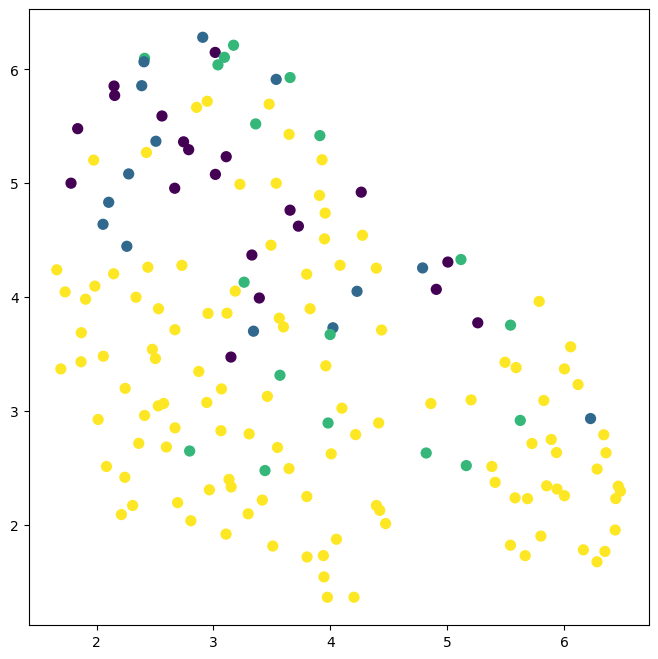

In [ ]:
reducer = umap.UMAP(n_components=2)
data_umap=reducer.fit_transform(pain)

fig = plt.figure(figsize=(8,8))
ax = plt.axes()
ax.scatter(data_umap[:,0], data_umap[:,1],c=target,s=50)

## TSNE

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 168 samples in 0.001s...
[t-SNE] Computed neighbors for 168 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 168 / 168
[t-SNE] Mean sigma: 4.844205
[t-SNE] Computed conditional probabilities in 0.013s
[t-SNE] Iteration 50: error = 56.2312317, gradient norm = 0.3275748 (50 iterations in 0.680s)
[t-SNE] Iteration 100: error = 59.0038834, gradient norm = 0.3019549 (50 iterations in 0.431s)
[t-SNE] Iteration 150: error = 58.4293823, gradient norm = 0.2930100 (50 iterations in 0.269s)
[t-SNE] Iteration 200: error = 58.0094833, gradient norm = 0.6318235 (50 iterations in 0.443s)
[t-SNE] Iteration 250: error = 59.5459061, gradient norm = 0.4136137 (50 iterations in 0.246s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.545906
[t-SNE] Iteration 300: error = 0.7115717, gradient norm = 0.0072019 (50 iterations in 0.138s)
[t-SNE] Iteration 350: error = 0.6624708, gradient norm = 0.0047980 

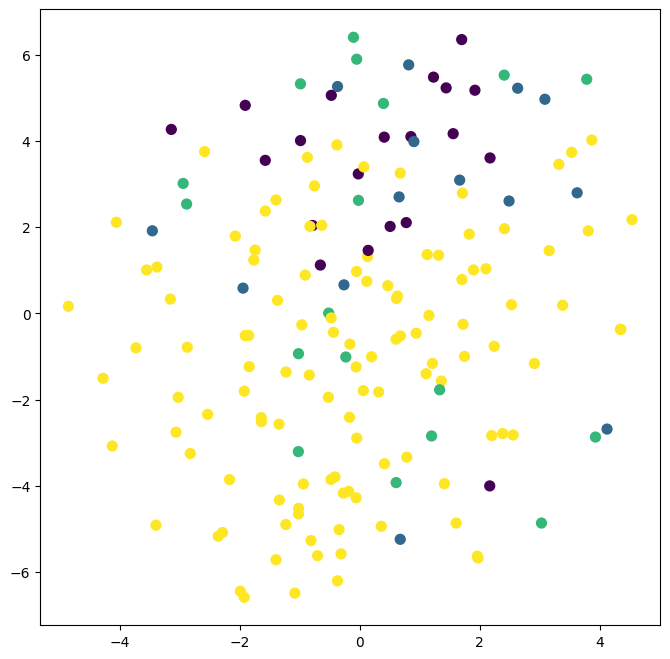

In [ ]:

tsne=TSNE(n_components=2,perplexity=40,init='random' ,learning_rate='auto',verbose=2)

data_tsne=tsne.fit_transform(pain)

fig = plt.figure(figsize=(8,8))
ax = plt.axes()
ax.scatter(data_tsne[:,0], data_tsne[:,1],c=target,s=50)

## PCA

In [ ]:
pca2 = PCA(n_components=2)
pca_columns = ['PCA_1','PCA_2']

# Transforming both scaled data into PCA versions.
data_pca= pca2.fit_transform(pain)

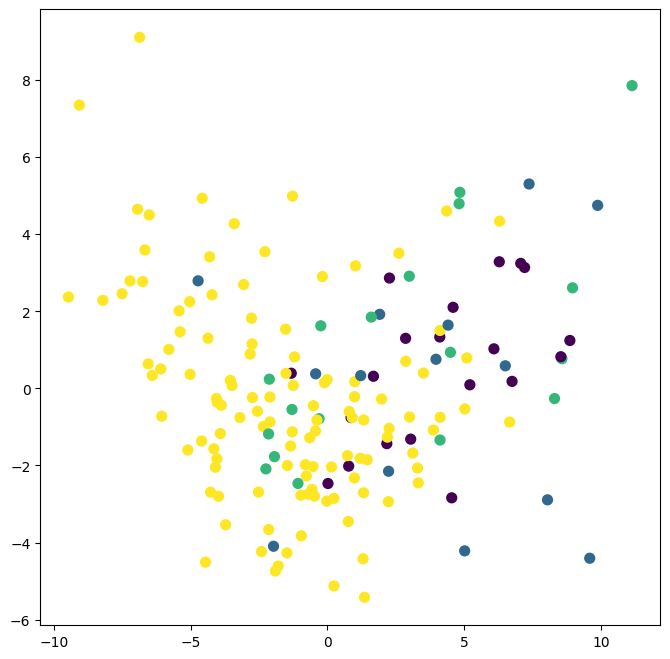

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = plt.axes()
ax.scatter(data_pca[:,0], data_pca[:,1],c=target,s=50)

In [ ]:
pain.shape

(168, 130)

In [ ]:
# axes1[2].scatter(data_pca[:,0], data_pca[:,1],c=target,s=50)

## Autoencoder




In [ ]:
pain_auto=pain.to_numpy()

from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test = train_test_split(pain_auto,target ,random_state=89)

dataset=[(x,y) for x,y in zip(x_train,y_train)]
data_set=[(x,y) for x,y in zip(x_test,y_test)]

train_loader=DataLoader(dataset, batch_size=6, shuffle=True)
test_loader=DataLoader(data_set,batch_size=6,shuffle=True)


In [ ]:
x_train.shape

(126, 130)

In [ ]:
x_test.shape

(42, 130)

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
class Autoencodeur(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(130, 2)

        )
        self.decoder = nn.Sequential(
            nn.Linear(2, 130)
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

model = Autoencodeur().to(device)
model=model.double()
learning_rate = 0.001

optimizer = torch.optim.Adam(
    model.parameters(),
    lr=learning_rate
)
mse=nn.MSELoss()


In [ ]:
# # Perform some checks
# print("Original shape of X:", np.asarray(X).shape)

# # Verify the size of the array
# print("Size of X:", len(X) * len(X[0]))

## Trainning

21
epoch : 1/400,  loss = 1.3302
epoch : 2/400,  loss = 1.2603
epoch : 3/400,  loss = 1.2210
epoch : 4/400,  loss = 1.1933
epoch : 5/400,  loss = 1.1728
epoch : 6/400,  loss = 1.1563
epoch : 7/400,  loss = 1.1423
epoch : 8/400,  loss = 1.1302
epoch : 9/400,  loss = 1.1196
epoch : 10/400,  loss = 1.1098
epoch : 11/400,  loss = 1.1008
epoch : 12/400,  loss = 1.0929
epoch : 13/400,  loss = 1.0851
epoch : 14/400,  loss = 1.0779
epoch : 15/400,  loss = 1.0711
epoch : 16/400,  loss = 1.0647
epoch : 17/400,  loss = 1.0587
epoch : 18/400,  loss = 1.0526
epoch : 19/400,  loss = 1.0469
epoch : 20/400,  loss = 1.0414
epoch : 21/400,  loss = 1.0360
epoch : 22/400,  loss = 1.0306
epoch : 23/400,  loss = 1.0251
epoch : 24/400,  loss = 1.0197
epoch : 25/400,  loss = 1.0143
epoch : 26/400,  loss = 1.0086
epoch : 27/400,  loss = 1.0030
epoch : 28/400,  loss = 0.9969
epoch : 29/400,  loss = 0.9906
epoch : 30/400,  loss = 0.9846
epoch : 31/400,  loss = 0.9780
epoch : 32/400,  loss = 0.9717
epoch : 33/400

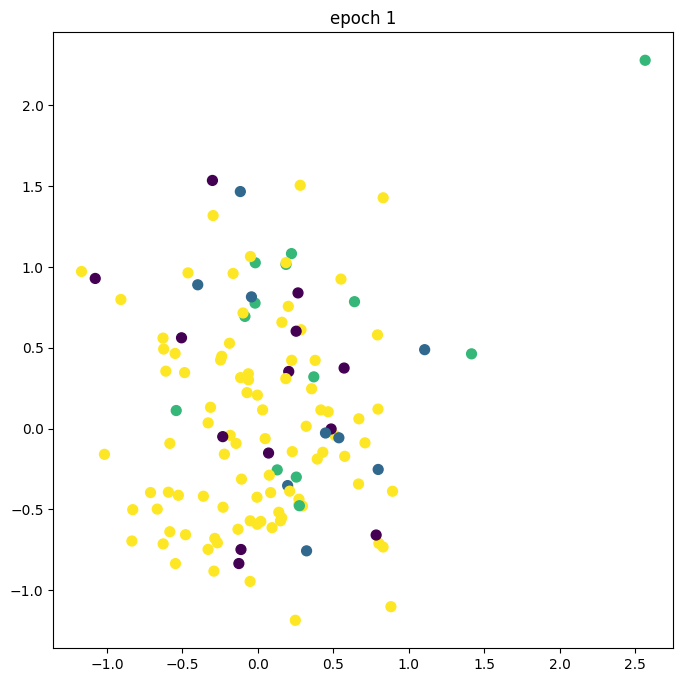

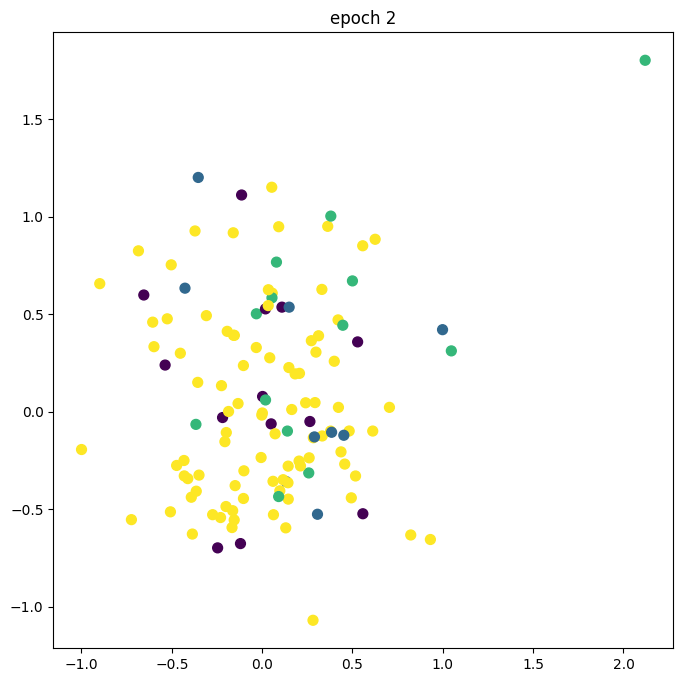

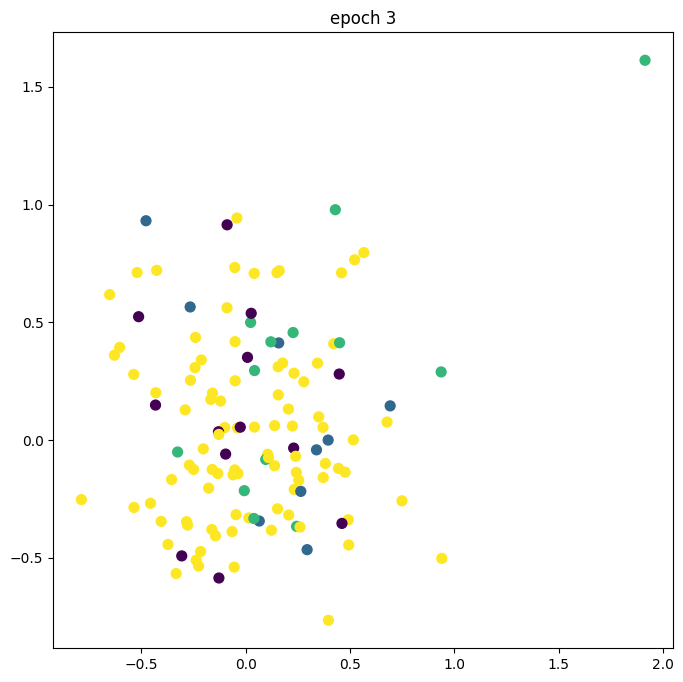

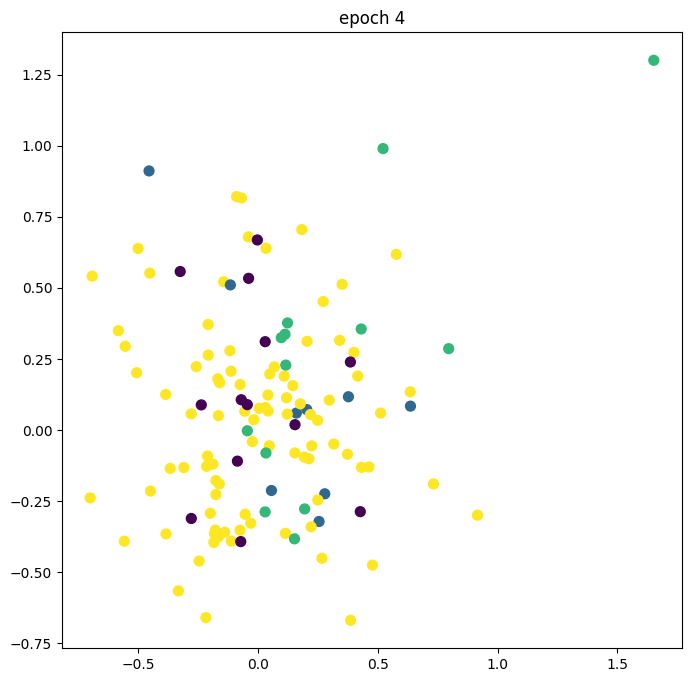

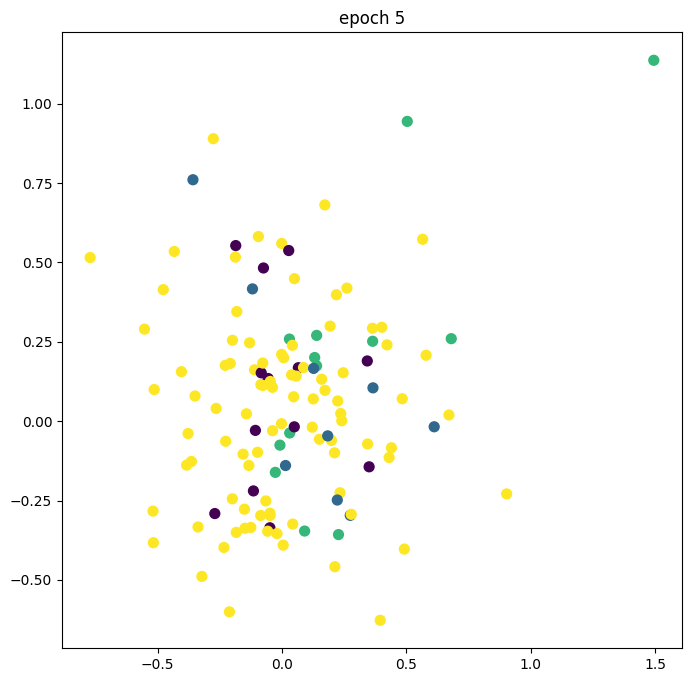

...

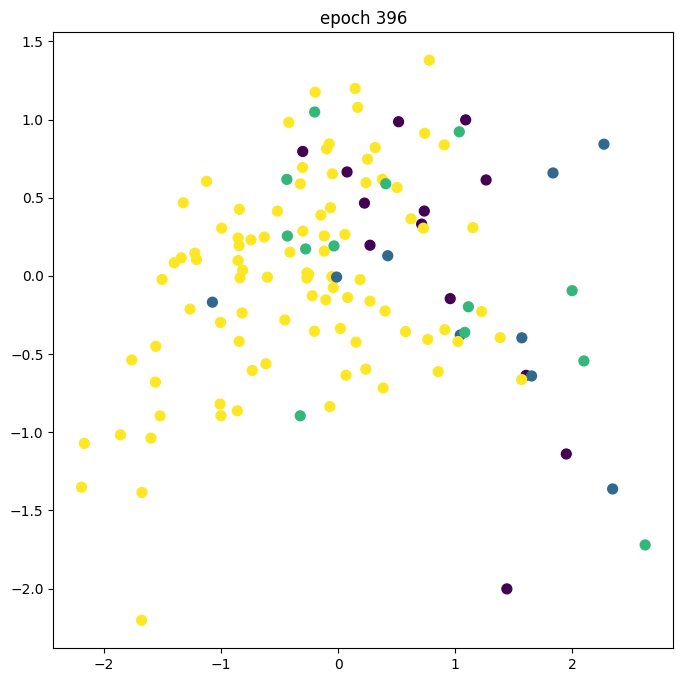

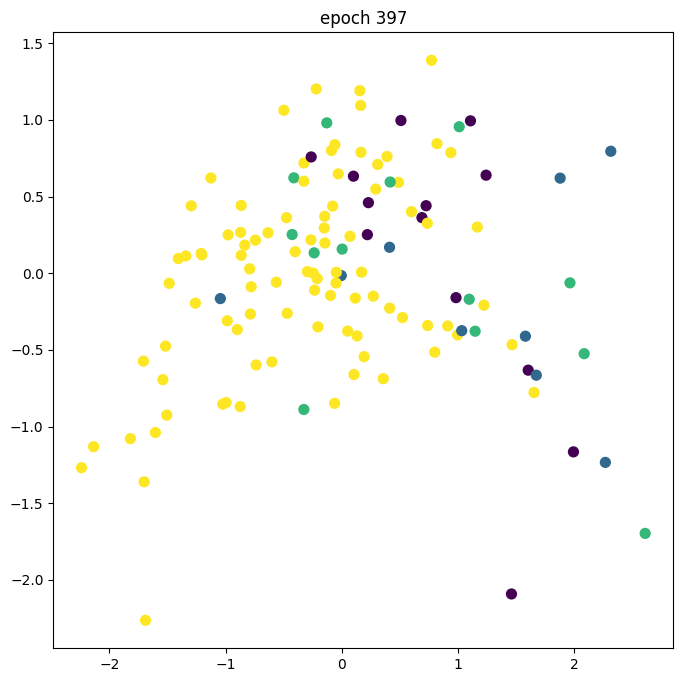

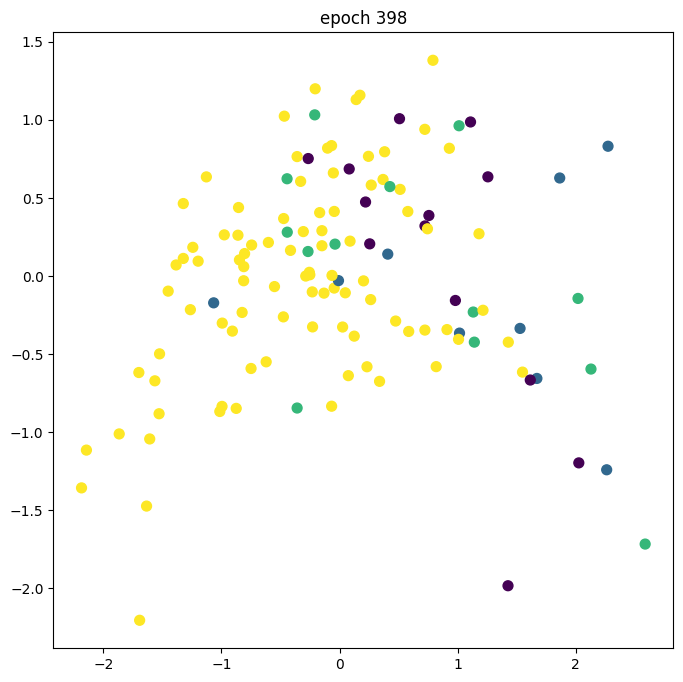

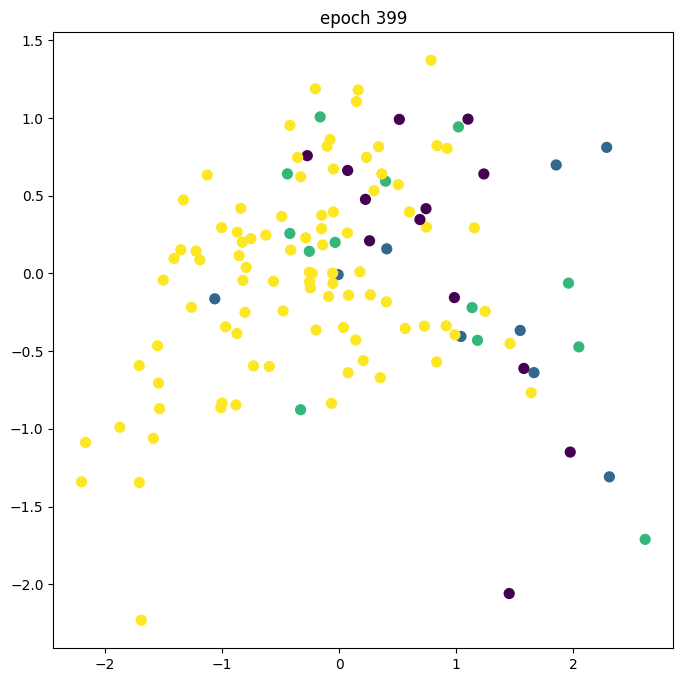

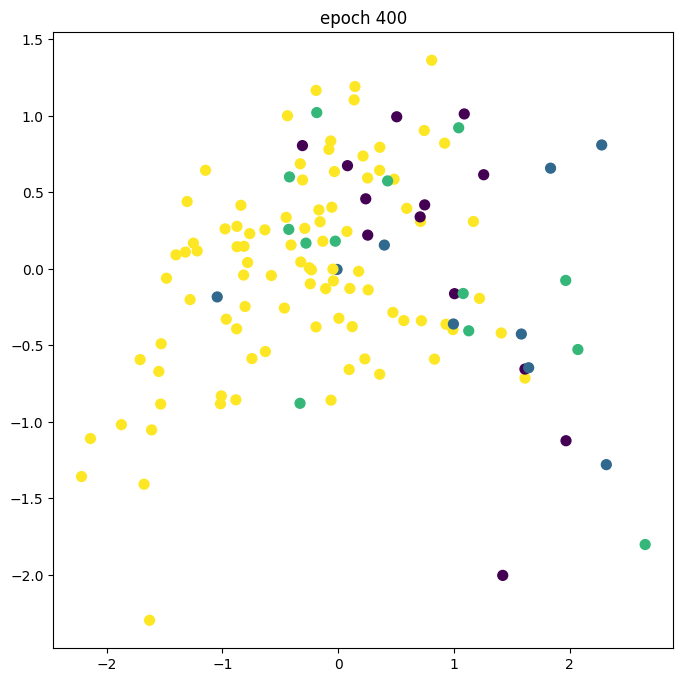

In [ ]:
from gtda.diagrams import Amplitude
import sklearn
# train_loader=DataLoader(dataset, batch_size=2, shuffle=True)
losses=[]

num_epochs=400

batch_size = len(train_loader)
print(batch_size)

for epoch in range(num_epochs):

    X=[]
    Y=[]

    total_loss = 0

    for data in train_loader:

        x,y=data


        output = model(x)
        e=model.encoder(x).detach().numpy()

        X.append(e)
        Y.append(y.numpy())



        loss = mse(output, x)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.data
    total_loss = total_loss / batch_size
    losses.append(total_loss)

    Y=np.asarray(Y).reshape(1,-1)
    # Perform some checks
    # print("Original shape of X:", np.asarray(X).shape)

    # Verify the size of the array ***
    # print("Size of X:", len(X) * len(X[0]))
    # print(X[0],len(X))
    X=np.asarray(X).reshape(126,2)
    # print(X.shape)


    print("epoch : {}/{},  loss = {:.4f}".format(epoch + 1, num_epochs, total_loss))

    fig = plt.figure(figsize=(8,8))
    ax = plt.axes()
    ax.scatter(X[:,0], X[:,1],c=Y,s=50)
    ax.set_title('epoch {}'.format(epoch+1))
    plt.savefig('ae{}.png'.format(epoch+1), dpi = 300)

### Visualization of loss function

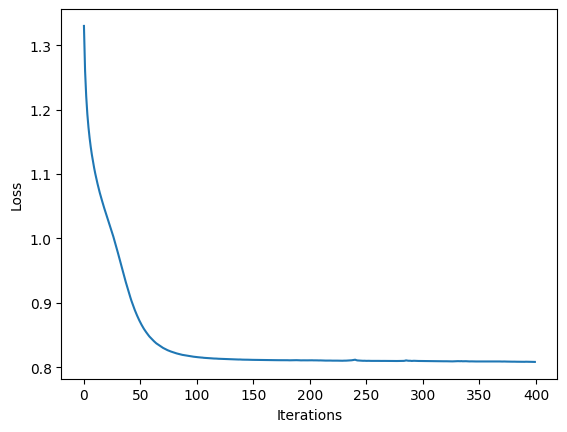

In [ ]:
plt.plot(losses[:])
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.show()

    # Verify the size of the array
    print("Size of X:", len(X) * len(X[0]))

### Test

7
7
====> Test set loss: 0.8091


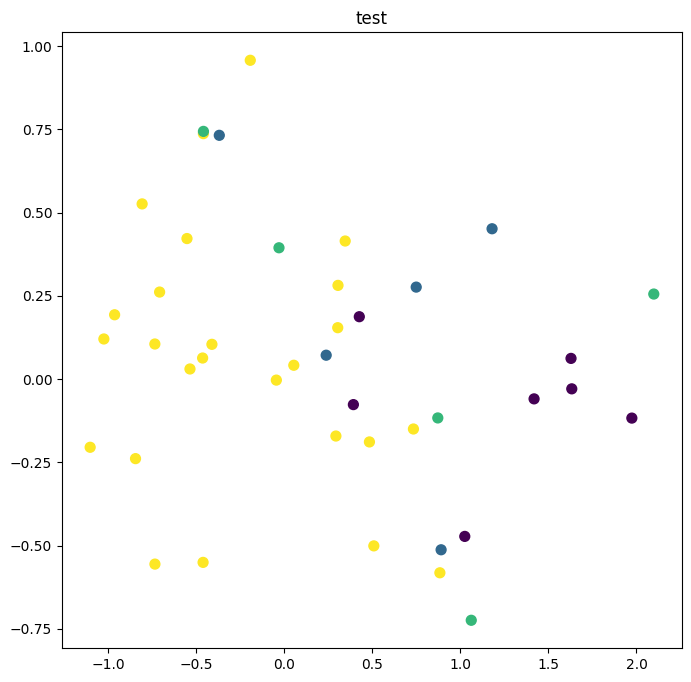

In [ ]:
test_loss = 0

batch_size = len(test_loader)
print(batch_size)
print(len(test_loader))
with torch.no_grad():
    X=[]
    Y=[]

    for data in test_loader:
        x,y=data

        output = model(x)

        e=model.encoder(x).detach().numpy()

        X.append(e)

        Y.append(y.numpy())




        loss = mse(output, x)
        test_loss += loss.item()

    test_loss /= len(test_loader)
    print('====> Test set loss: {:.4f}'.format(test_loss))

    Y=np.asarray(Y).reshape(1,-1)

    X=np.asarray(X).reshape(42,2)

    fig = plt.figure(figsize=(8,8))
    ax = plt.axes()
    ax.scatter(X[:,0], X[:,1],c=Y,s=50)
    ax.set_title('test')


## Visualization of the latent space

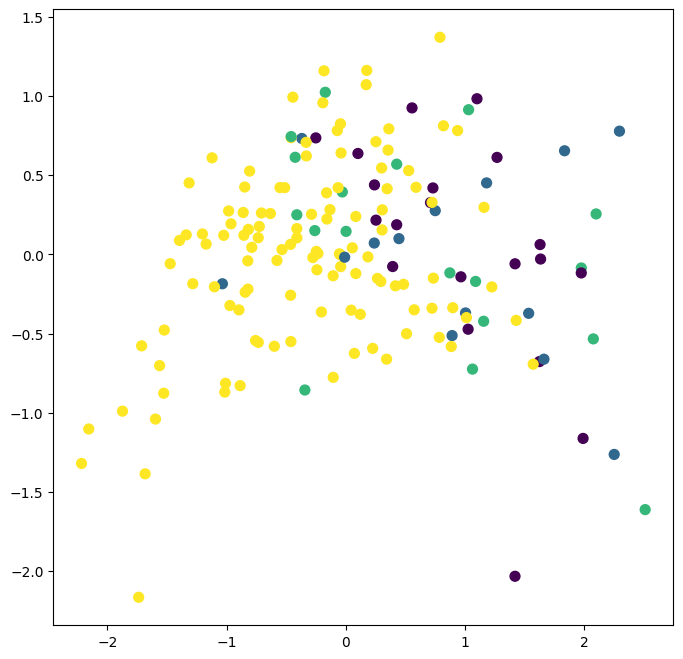

In [ ]:
data=pain.loc[:,pain.columns]
data=data.to_numpy()
m=model.encoder(torch.from_numpy(data))

fig = plt.figure(figsize=(8,8))
ax = plt.axes()
ax.scatter(m[:,0].detach().numpy(), m[:,1].detach().numpy(),c=target,s=50)

In [ ]:
# axes1[1].scatter(m[:,0].detach().numpy(), m[:,1].detach().numpy(),c=target,s=50)

### Topological Autoencoder

In [ ]:
# pain.values.reshape(pain.shape[0],pain.shape[1],1)

In [ ]:
persistence = VietorisRipsPersistence(metric = 'euclidean',homology_dimensions=[0,1,2],n_jobs=-1,collapse_edges=True)



In [ ]:
model1 = Autoencodeur().to(device)
model1=model1.double()
learning_rate = 0.001

optimizer = torch.optim.Adam(
    model1.parameters(),
    lr=learning_rate
)
mse=nn.MSELoss()

epoch : 1/400,  loss = 1.3099
epoch : 2/400,  loss = 1.2433
epoch : 3/400,  loss = 1.2089
epoch : 4/400,  loss = 1.1829
epoch : 5/400,  loss = 1.1634
epoch : 6/400,  loss = 1.1471
epoch : 7/400,  loss = 1.1329
epoch : 8/400,  loss = 1.1208
epoch : 9/400,  loss = 1.1094
epoch : 10/400,  loss = 1.0986
epoch : 11/400,  loss = 1.0880
epoch : 12/400,  loss = 1.0767
epoch : 13/400,  loss = 1.0664
epoch : 14/400,  loss = 1.0561
epoch : 15/400,  loss = 1.0461
epoch : 16/400,  loss = 1.0363
epoch : 17/400,  loss = 1.0254
epoch : 18/400,  loss = 1.0151
epoch : 19/400,  loss = 1.0059
epoch : 20/400,  loss = 0.9957
epoch : 21/400,  loss = 0.9870
epoch : 22/400,  loss = 0.9775
epoch : 23/400,  loss = 0.9682
epoch : 24/400,  loss = 0.9609
epoch : 25/400,  loss = 0.9530
epoch : 26/400,  loss = 0.9446
epoch : 27/400,  loss = 0.9382
epoch : 28/400,  loss = 0.9309
epoch : 29/400,  loss = 0.9257
epoch : 30/400,  loss = 0.9201
epoch : 31/400,  loss = 0.9152
epoch : 32/400,  loss = 0.9096
epoch : 33/400,  

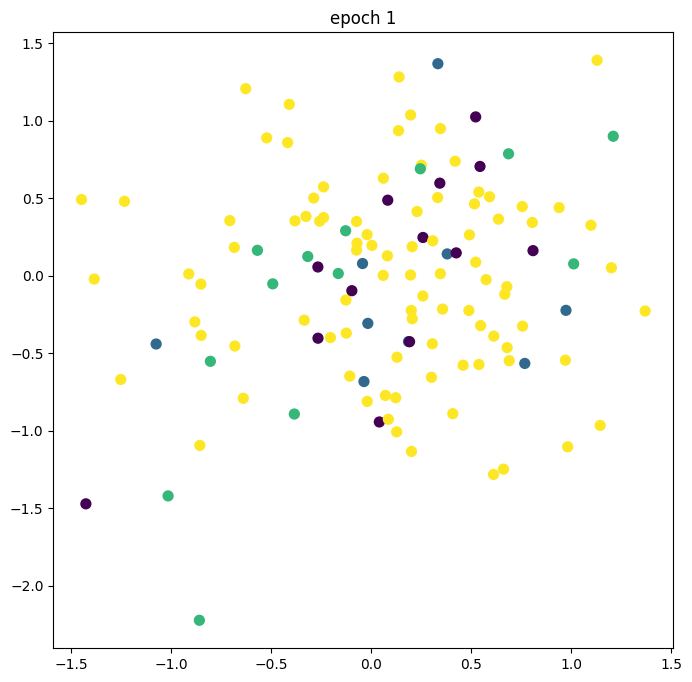

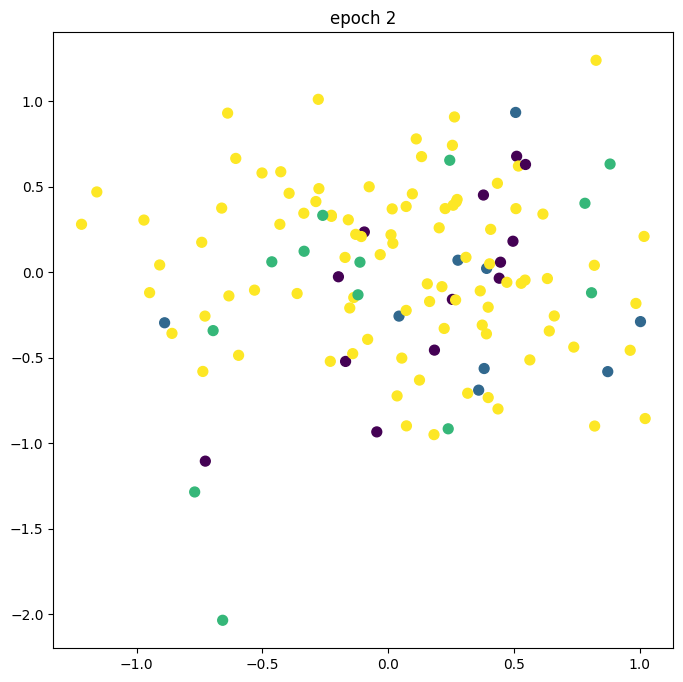

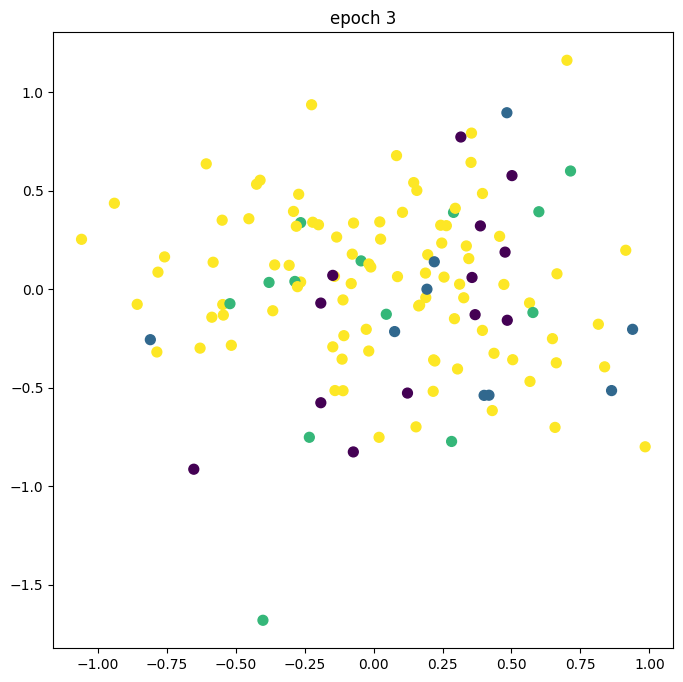

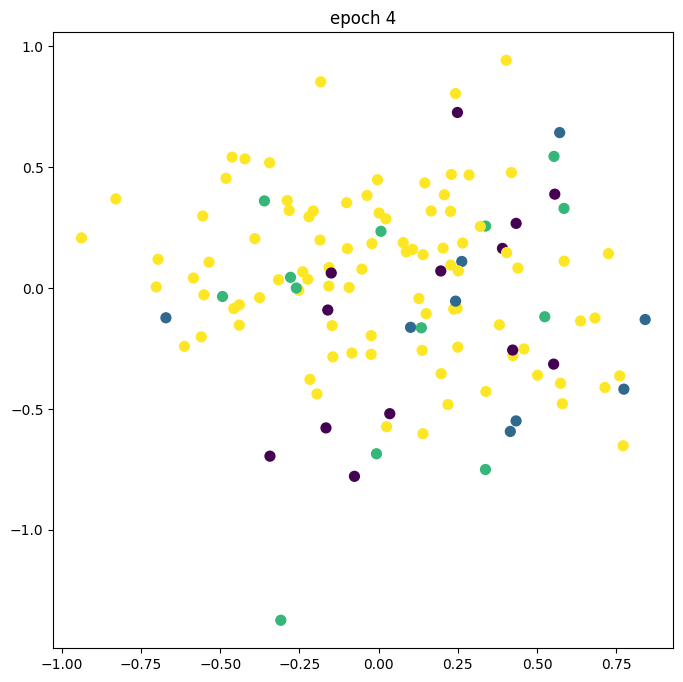

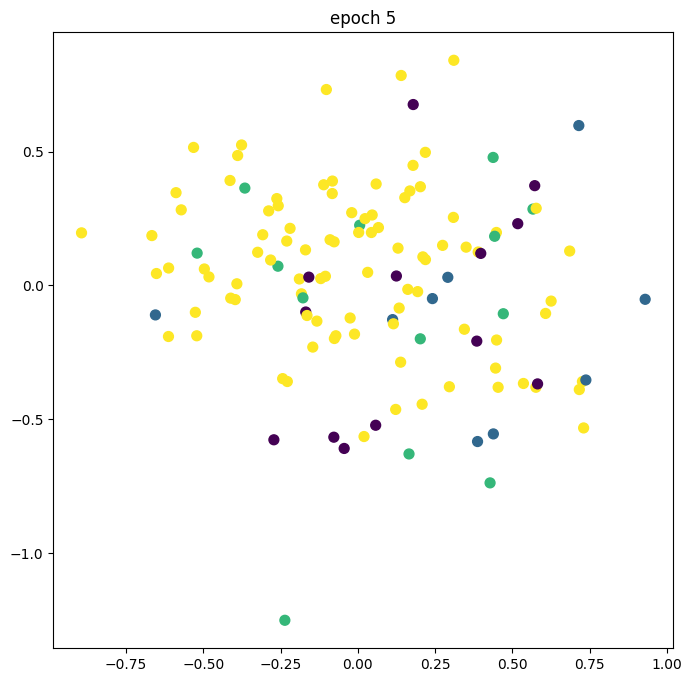

...

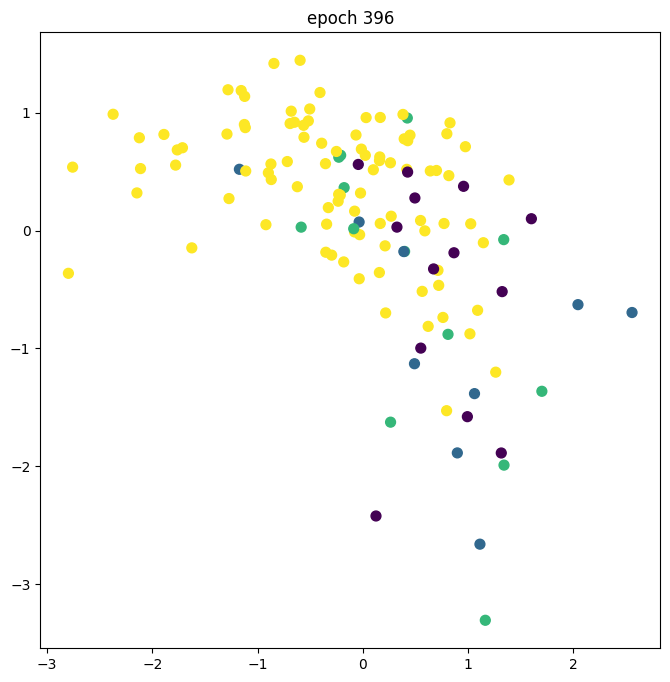

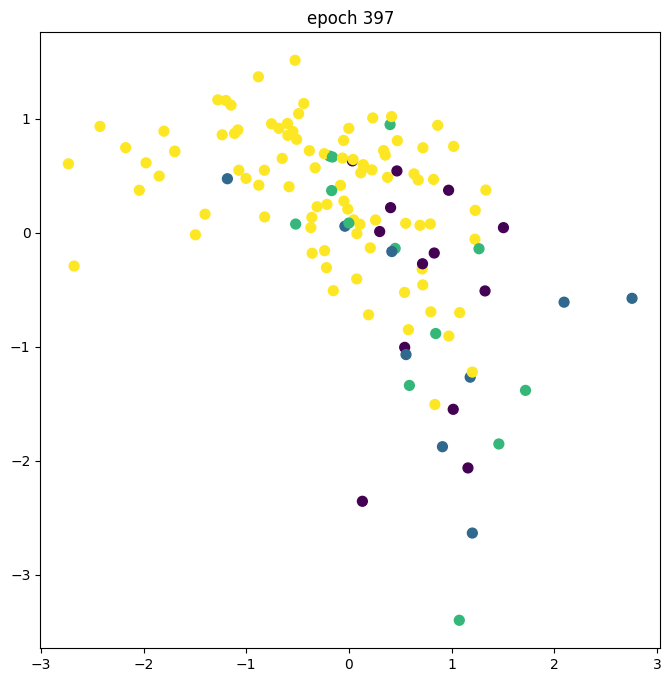

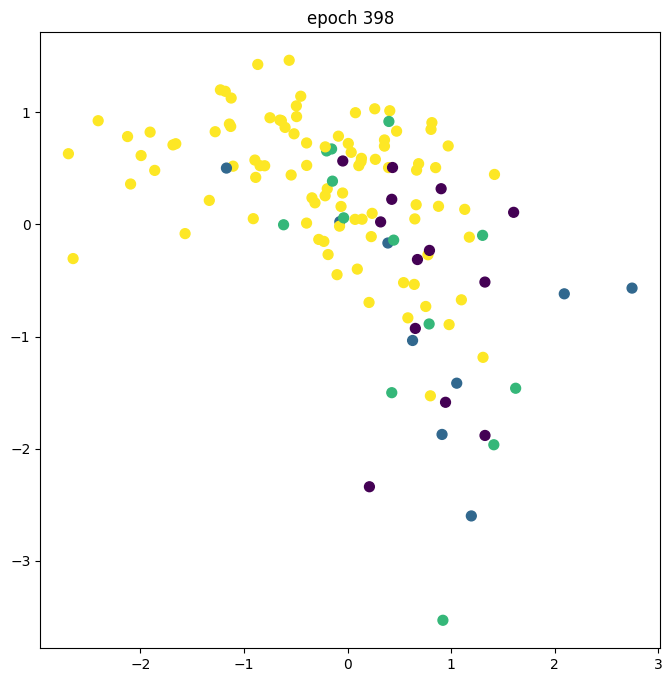

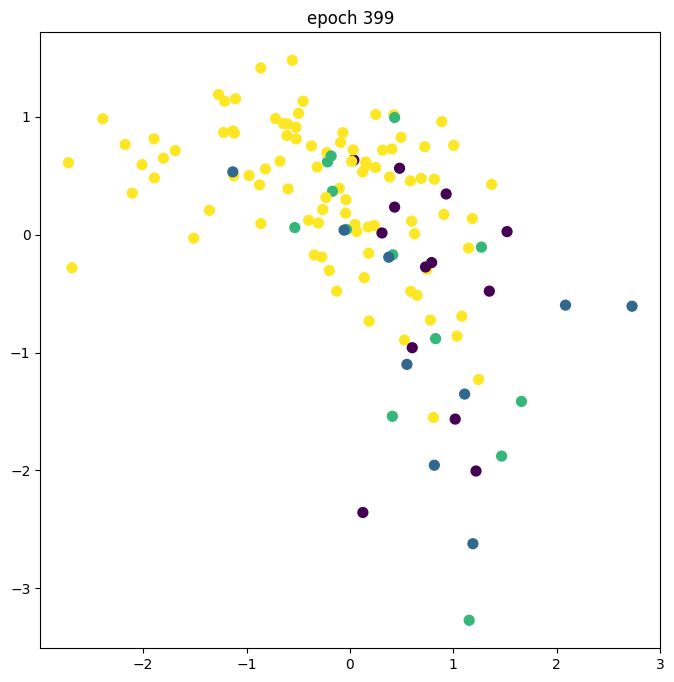

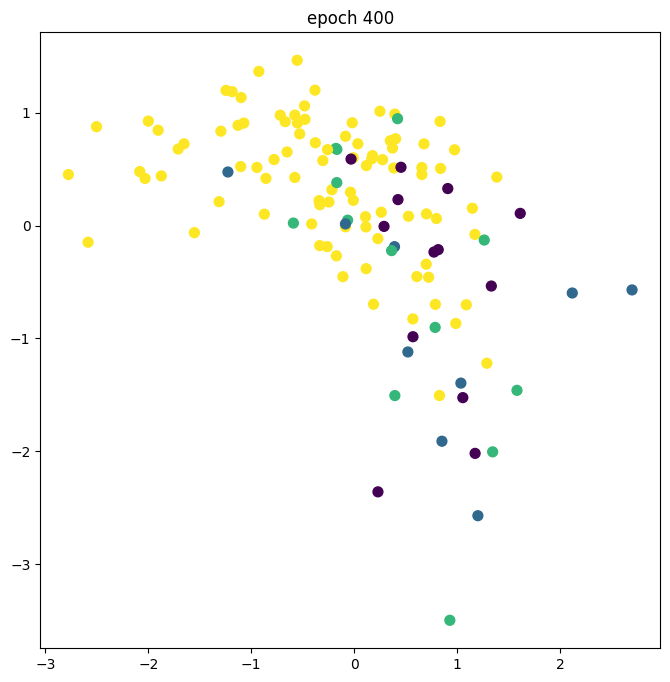

In [ ]:
from gtda.diagrams import Amplitude
import sklearn

losses=[]

num_epochs=400

batch_size = len(train_loader)


for epoch in range(num_epochs):

    X=[]
    Y=[]

    total_loss = 0

    for data in train_loader:

        x,y=data


        output = model1(x)
        e=model1.encoder(x).detach().numpy()

        X.append(e)
        Y.append(y.numpy())


        dy=persistence.fit_transform(output.detach().numpy()[None,:,:])
        dz=persistence.fit_transform(e[None,:,:])
        dx=persistence.fit_transform(x[None,:,:])

        a1=Amplitude(metric='bottleneck').fit_transform(dx)
        a2=Amplitude(metric='wasserstein').fit_transform(dx)
        a3=Amplitude(metric='landscape').fit_transform(dx)
        a4=Amplitude(metric='betti').fit_transform(dx)
        a5=Amplitude(metric='persistence_image').fit_transform(dx)

        a=a1+a2+a3+a4+a5

        b1=Amplitude(metric='bottleneck').fit_transform(dz)
        b2=Amplitude(metric='wasserstein').fit_transform(dz)
        b3=Amplitude(metric='landscape').fit_transform(dz)
        b4=Amplitude(metric='betti').fit_transform(dz)
        b5=Amplitude(metric='persistence_image').fit_transform(dz)

        b=b1+b2+b3+b4+b5

        c1=Amplitude(metric='bottleneck').fit_transform(dy)
        c2=Amplitude(metric='wasserstein').fit_transform(dy)
        c3=Amplitude(metric='landscape').fit_transform(dy)
        c4=Amplitude(metric='betti').fit_transform(dy)
        c5=Amplitude(metric='persistence_image').fit_transform(dy)

        c=c1+c2+c3+c4+c5


        l1=(np.linalg.norm(a-b)**2)/2

        l2=(np.linalg.norm(b-c)**2)/2

        l=l1+l2


        loss = mse(output, x)+(1e-5)*l

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.data
    total_loss = total_loss / batch_size
    losses.append(total_loss)

    Y=np.asarray(Y).reshape(1,-1)
    X=np.asarray(X).reshape(126,2)


    print("epoch : {}/{},  loss = {:.4f}".format(epoch + 1, num_epochs, total_loss))

    fig = plt.figure(figsize=(8,8))
    ax = plt.axes()
    ax.scatter(X[:,0], X[:,1],c=Y,s=50)
    ax.set_title('epoch {}'.format(epoch+1))
    plt.savefig('{}.png'.format(epoch+1), dpi = 300)

## Visualisation of loss function

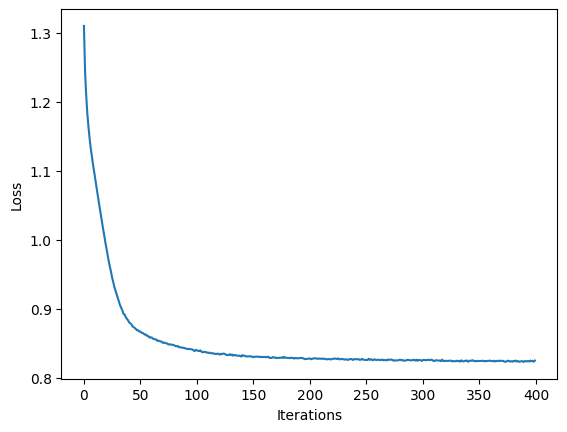

In [ ]:
plt.plot(losses[:])
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.show()

====> Test set loss: 0.8204


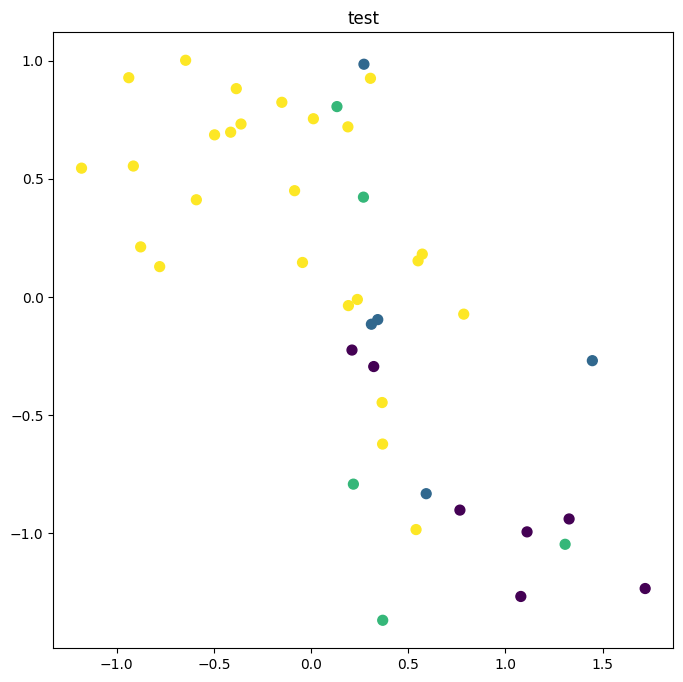

In [ ]:
test_loss = 0


with torch.no_grad():
    X=[]
    Y=[]

    for data in test_loader:
        x,y=data

        output = model1(x)

        e=model1.encoder(x).detach().numpy()

        X.append(e)

        Y.append(y.numpy())


        dy=persistence.fit_transform(output.detach().numpy()[None,:,:])
        dz=persistence.fit_transform(e[None,:,:])
        dx=persistence.fit_transform(x[None,:,:])

        a1=Amplitude(metric='bottleneck').fit_transform(dx)
        a2=Amplitude(metric='wasserstein').fit_transform(dx)
        a3=Amplitude(metric='landscape').fit_transform(dx)
        a4=Amplitude(metric='betti').fit_transform(dx)
        a5=Amplitude(metric='persistence_image').fit_transform(dx)

        a=a1+a2+a3+a4+a5

        b1=Amplitude(metric='bottleneck').fit_transform(dz)
        b2=Amplitude(metric='wasserstein').fit_transform(dz)
        b3=Amplitude(metric='landscape').fit_transform(dz)
        b4=Amplitude(metric='betti').fit_transform(dz)
        b5=Amplitude(metric='persistence_image').fit_transform(dz)

        b=b1+b2+b3+b4+b5

        c1=Amplitude(metric='bottleneck').fit_transform(dy)
        c2=Amplitude(metric='wasserstein').fit_transform(dy)
        c3=Amplitude(metric='landscape').fit_transform(dy)
        c4=Amplitude(metric='betti').fit_transform(dy)
        c5=Amplitude(metric='persistence_image').fit_transform(dy)

        c=c1+c2+c3+c4+c5


        l1=(np.linalg.norm(a-b)**2)/2

        l2=(np.linalg.norm(b-c)**2)/2

        l=l1+l2

        loss = mse(output, x)+(1e-5)*l
        test_loss += loss.item()

    test_loss /= len(test_loader)
    print('====> Test set loss: {:.4f}'.format(test_loss))

    Y=np.asarray(Y).reshape(1,-1)
    X=np.asarray(X).reshape(42,2)

    fig = plt.figure(figsize=(8,8))
    ax = plt.axes()
    ax.scatter(X[:,0], X[:,1],c=Y,s=50)
    ax.set_title('test')


### Visualization of latent space

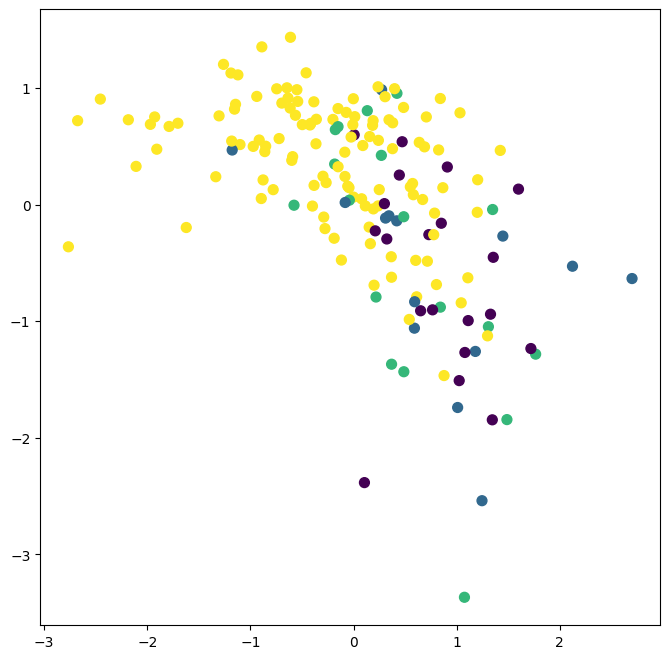

In [ ]:
# data=pain.loc[:,pain.columns]
data=pain.to_numpy()

m1=model1.encoder(torch.from_numpy(data))

fig = plt.figure(figsize=(8,8))
ax = plt.axes()
ax.scatter(m1[:,0].detach().numpy(), m1[:,1].detach().numpy(),c=target,s=50)

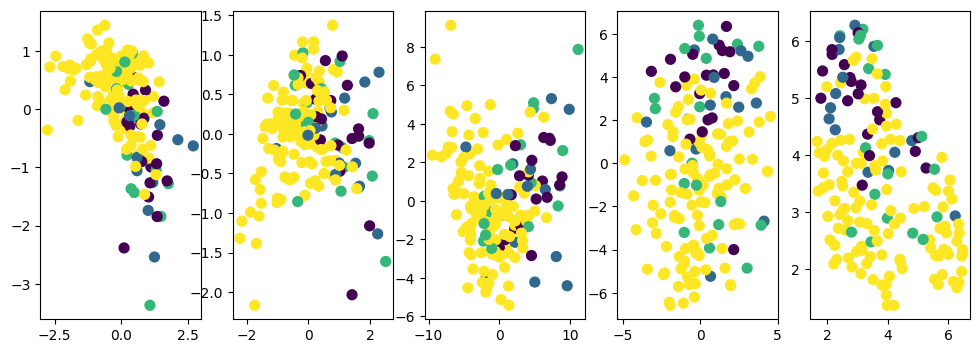

In [ ]:
fig1, axes1 = plt1.subplots(nrows=1, ncols=5, figsize=(12, 4))  # 1 row, 5 columns
axes1[0].scatter(m1[:,0].detach().numpy(), m1[:,1].detach().numpy(),c=target,s=50)
axes1[1].scatter(m[:,0].detach().numpy(), m[:,1].detach().numpy(),c=target,s=50)
axes1[2].scatter(data_pca[:,0], data_pca[:,1],c=target,s=50)
axes1[3].scatter(data_tsne[:,0], data_tsne[:,1],c=target,s=50)
axes1[4].scatter(data_umap[:,0], data_umap[:,1],c=target,s=50)

# Save the entire figure with all subplots
plt1.savefig('pain_dimension_reduction.png',dpi=300)

# Show the plots (optional)
plt.show()

In [ ]:
import matplotlib.animation as animation
import os

# Directory containing PNG files
png_directory = '/content/'

# Output MP4 file
output_mp4 = 'output_video.mp4'


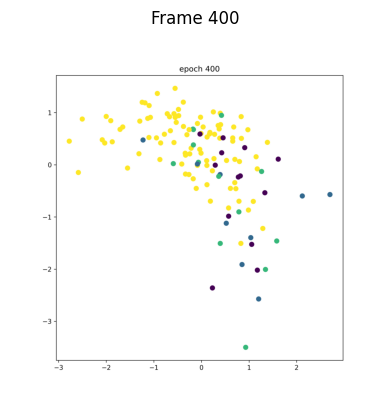

In [ ]:
# Output MP4 file
output_mp4 = 'output_video.mp4'

# Function to generate a plot for each frame
def update(frame):
    plt.clf()  # Clear the previous plot
    filename = os.path.join(png_directory, f'{frame}.png')  # Assuming the files are named 1.png, 2.png, ..., 200.png
    img = plt.imread(filename)
    plt.imshow(img)
    plt.title(f'Frame {frame}')
    plt.axis('off')

# Create a figure
fig = plt.figure()


selected_frames = [frame for frame in range(1, 401) if not'ae' in f'{frame}.png']

# Create an animation
ani = animation.FuncAnimation(fig, update, frames=selected_frames, blit=False)

# Save the animation as an MP4 file using ffmpeg
ani.save(output_mp4, writer='ffmpeg', fps=10)  # Adjust the fps parameter as needed

# Show the plot
plt.show()

In [ ]:
def matrice_distance(data):
    d=euclidean_distances(data,data)
    d=preprocessing.normalize(d)
    return d

def estimateur(data,d,sigma):
    f=[]
    for i in range(40):
        s=0
        for j in range(40):
            s=s+math.exp(- (d[i][j]**2)*(sigma**(-1)))
        f.append(s)
    return f

def KL(a, b):
    a = np.asarray(a, dtype=np.float64)
    b = np.asarray(b, dtype=np.float64)

    return np.sum(np.where(a != 0, a * np.log(a / b), 0))

In [ ]:
def evaluation(data,A,B):
    sigma=[0.01,0.1,1]

    f=[estimateur(data,B,sigma) for sigma in sigma]

    g=[estimateur(data,A,sigma) for sigma in sigma]


    kl=[]
    for i in range(3):
        kl.append(KL(f[i],g[i]))

    RMSE=[]
    MSE = np.square(np.subtract(B,A)).mean()
    RMSE.append(math.sqrt(MSE))

    from sklearn.manifold import trustworthiness
    Trust=[]
    Trust.append(sklearn.manifold.trustworthiness(B,A))



    Tab=pd.DataFrame([kl])
    Tab.columns=['KL_0.01','KL_0.1','KL_1']
    Tab['MSE']=MSE
    Tab['RMSE']=RMSE
    Tab['Trust']=Trust
    return Tab

### TSNE Evaluation

In [ ]:
A=matrice_distance(data_tsne)
B=d=matrice_distance(pain)

In [ ]:
evaluation(pain,A,B)

,KL_0.01,KL_0.1,KL_1,RMSE,Trust
0,-99.575404,-6.511604,-0.558588,0.028054,0.932165


### Umap Evaluation

In [ ]:
A=matrice_distance(data_umap)


In [ ]:
evaluation(pain,A,B)

,KL_0.01,KL_0.1,KL_1,RMSE,Trust
0,-114.117807,-10.783369,-1.034721,0.029763,0.872894


### PCA Evaluation

In [ ]:
A=matrice_distance(data_pca)


In [ ]:
evaluation(pain,A,B)

,KL_0.01,KL_0.1,KL_1,RMSE,Trust
0,-118.028656,-3.329322,-0.051022,0.030476,0.869308


### Autoencoder Evaluation

In [ ]:
m=m.detach().numpy()
A=matrice_distance(m)


In [ ]:
evaluation(pain,A,B)

,KL_0.01,KL_0.1,KL_1,RMSE,Trust
0,-118.876802,-4.625776,-0.222097,0.030615,0.856376


### Taelcore

In [ ]:
m1=m1.detach().numpy()
A=matrice_distance(m1)


In [ ]:
evaluation(pain,A,B)

,KL_0.01,KL_0.1,KL_1,RMSE,Trust
0,-126.05364,-2.194958,0.147849,0.032006,0.843006
